In [1]:
import cv2
import numpy as np
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D
import os

In [28]:


def feature_matching(img1, img2):
    # Feature extraction
    sift = cv2.SIFT_create()
    kp1, des1 = sift.detectAndCompute(img1, None)
    kp2, des2 = sift.detectAndCompute(img2, None)

    # Feature matching
    bf = cv2.BFMatcher()
    matches = bf.knnMatch(des1, des2, k=2)

    # Apply ratio test
    good_matches = []
    for m, n in matches:
        if m.distance < 0.75 * n.distance:
            good_matches.append(m)

    src_pts = np.float32([kp1[m.queryIdx].pt for m in good_matches]).reshape(-1, 1, 2)
    dst_pts = np.float32([kp2[m.trainIdx].pt for m in good_matches]).reshape(-1, 1, 2)

    return src_pts, dst_pts

def normalize_image(img):
    # Scale pixel values to the range [0, 1]
    imgg = cv2.normalize(img, None, 0,255, cv2.NORM_MINMAX)
    # plt.figure()
    # plt.imshow(imgg, cmap="gray")
    return imgg


def sfm(images1, K):
    image_files = []
    images_dir = 'C:/Users/ROHIT/Downloads/Structure-From-Motion-SFM--master/Structure-From-Motion-SFM--master/data/images/buddha'
    for filename in os.listdir(images_dir)[0:6]:
        file = os.path.join(images_dir, filename)
        img = cv2.imread(file, 0)
        image_files.append(img)
    images = image_files
    # Load the first image
    img1 = images[0]
    gray1 = img1


    # Initialize 3D point cloud
    points_3d = np.zeros((0, 3))
    points_2d = np.zeros((0, 2))

    for i in range(1, len(images)):
        # Load the next image
        gray2 = images[i]
        img2 = images[i]
        camera_poses = []
        
        # Normalize images
        img1_normalized = normalize_image(gray1)
        img2_normalized = normalize_image(gray2)

        # Feature matching
        src_pts, dst_pts = feature_matching(img1_normalized, img2_normalized)

        # Draw feature points on the images
        img1_with_points = cv2.drawKeypoints(gray1, [cv2.KeyPoint(x, y, 5) for (x, y) in src_pts[:, 0]], None, flags=cv2.DRAW_MATCHES_FLAGS_DRAW_RICH_KEYPOINTS)
        img2_with_points = cv2.drawKeypoints(gray2, [cv2.KeyPoint(x, y, 5) for (x, y) in dst_pts[:, 0]], None, flags=cv2.DRAW_MATCHES_FLAGS_DRAW_RICH_KEYPOINTS)

        # Display images with feature points
        plt.figure(figsize=(16, 9))
        plt.subplot(1, 2, 1)
        plt.imshow(img1_with_points, cmap='gray')
        plt.title('Image 1 with Feature Points')
        plt.subplot(1, 2, 2)
        plt.imshow(img2_with_points, cmap='gray')
        plt.title('Image 2 with Feature Points')
        plt.show()

        # Draw epipolar lines on the images
        F, mask = cv2.findFundamentalMat(src_pts, dst_pts, cv2.FM_RANSAC)
        lines1 = cv2.computeCorrespondEpilines(dst_pts, 2, F)
        lines1 = lines1.reshape(-1, 3)
        lines2 = cv2.computeCorrespondEpilines(src_pts, 1, F)
        lines2 = lines2.reshape(-1, 3)

        # Convert points to integers for drawing lines
        src_pts_int = np.int32(src_pts[:, 0])
        dst_pts_int = np.int32(dst_pts[:, 0])

        # Draw lines on the images
        img1_epilines = img1_with_points.copy()
        img2_epilines = img2_with_points.copy()

        for r, pt1, pt2 in zip(lines1, src_pts_int, dst_pts_int):
            color = tuple(np.random.randint(0, 255, 3).tolist())
            x0, y0 = map(int, [0, -r[2] / r[1]])
            x1, y1 = map(int, [img1.shape[1], -(r[2] + r[0] * img1.shape[1]) / r[1]])

            # Draw epipolar line on the second image
            img2_epilines = cv2.line(img2_epilines, (x0, y0), (x1, y1), color, 1)

            # Draw corresponding point on the first image
            img1_epilines = cv2.circle(img1_epilines, tuple(pt1), 5, color, -1)
            
            x0, y0 = map(int, [0, -r[2] / r[1]])
            x1, y1 = map(int, [img2.shape[1], -(r[2] + r[0] * img2.shape[1]) / r[1]])

            # Draw epipolar line on the first image
            img1_epilines = cv2.line(img1_epilines, (x0, y0), (x1, y1), color, 1)

            # Draw corresponding point on the second image
            img2_epilines = cv2.circle(img2_epilines, tuple(pt2), 5, color, -1)

        # Display images with epipolar lines
        plt.figure(figsize=(16, 9))
        plt.subplot(1, 2, 1)
        plt.imshow(img1_epilines, cmap='gray')
        plt.title('Image 1 with Epipolar Lines')
        plt.subplot(1, 2, 2)
        plt.imshow(img2_epilines, cmap='gray')
        plt.title('Image 2 with Epipolar Lines')
        plt.show()



        # Recover essential matrix
        E, _ = cv2.findFundamentalMat(dst_pts, src_pts, cv2.FM_RANSAC)

        # Recover pose
        _, R, t, mask = cv2.recoverPose(E, dst_pts, src_pts, K)

        # Projection matrix [R | t]
        proj_matrix = np.hstack((R, t))

        # Triangulate points
        points_4d = cv2.triangulatePoints(np.eye(3, 4), proj_matrix, src_pts, dst_pts)
        points_3d_current = points_4d[:3, :].T

        # Append new points to the 3D point cloud
        points_3d = np.vstack((points_3d, points_3d_current))
        points_2d = np.vstack((points_2d, src_pts[:, 0, :]))

        # Save camera pose
        camera_poses.append((R, t))

        # Update current image and its features
        gray1 = gray2

    return points_3d, points_2d, camera_poses


        # # Update current image and its features
        # img1 = img2
        # gray1 = gray2


def plot_3d_points(points_3d):
    fig = plt.figure()
    ax = fig.add_subplot(111, projection='3d')
    ax.scatter(points_3d[:, 0], points_3d[:, 1], points_3d[:, 2], c='b', marker='o')
    ax.set_xlabel('X')
    ax.set_ylabel('Y')
    ax.set_zlabel('Z')
    ax.set_title('Reconstructed 3D Points')
    plt.show()


def plot_3d_points_and_poses(points_3d, camera_poses):
    fig = plt.figure(figsize=(12, 8))
    ax = fig.add_subplot(111, projection='3d')
    
    # Plot 3D points
    ax.scatter(points_3d[:, 0], points_3d[:, 1], points_3d[:, 2], c='b', marker='o', label='3D Points')

    # Plot camera poses
    for i, pose in enumerate(camera_poses):
        R, t = pose
        # Use the mean position of 3D points associated with the camera for annotation
        mean_position = np.mean(points_3d[i*len(t):(i+1)*len(t)], axis=0)
        ax.text(mean_position[0], mean_position[1], mean_position[2], f'Camera {i+1}', color='r')
        ax.quiver(t[0], t[1], t[2], R[0, 2], R[1, 2], R[2, 2], length=0.1, color='r', normalize=True, label='Camera Poses')

    ax.set_xlabel('X')
    ax.set_ylabel('Y')
    ax.set_zlabel('Z')
    ax.set_title('Reconstructed 3D Points and Camera Poses')
    ax.legend()
    plt.show()





In [27]:
# import os
# import cv2
# import numpy as np
# import matplotlib.pyplot as plt
# from mpl_toolkits.mplot3d import Axes3D

# def sfm(images, K):
#     # Initialize 3D point cloud and camera poses
#     points_3d = np.zeros((0, 3))
#     points_2d = np.zeros((0, 2))
#     camera_poses = []

#     for i in range(1, len(images)):
#         # Load the next image
#         img2 = images[i]
#         gray2 = img2

#         # Feature matching
#         src_pts, dst_pts = feature_matching(gray1, gray2)

#         # Recover essential matrix
#         E, _ = cv2.findEssentialMat(dst_pts, src_pts, K)

#         # Recover pose
#         _, R, t, mask = cv2.recoverPose(E, dst_pts, src_pts, K)

#         # Triangulate points
#         points_4d = cv2.triangulatePoints(np.eye(3), np.hstack((R, t)), src_pts, dst_pts)
#         points_3d_current = points_4d[:3, :].T

#         # Append new points to the 3D point cloud
#         points_3d = np.vstack((points_3d, points_3d_current))
#         points_2d = np.vstack((points_2d, src_pts[:, 0, :]))

#         # Save camera pose
#         camera_poses.append((R, t))

#         # Update current image and its features
#         img1 = img2
#         gray1 = gray2

#     return points_3d, points_2d, camera_poses



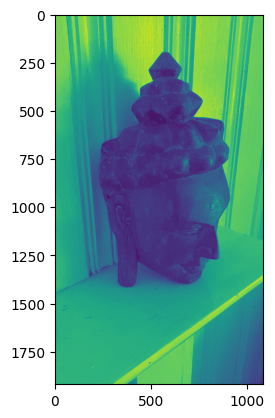

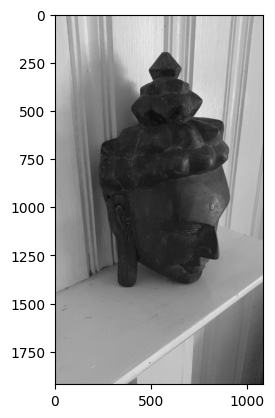

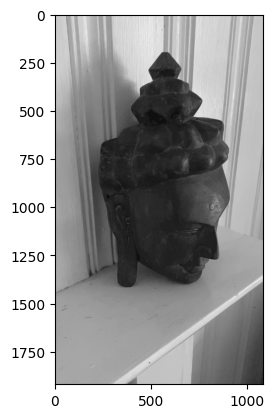

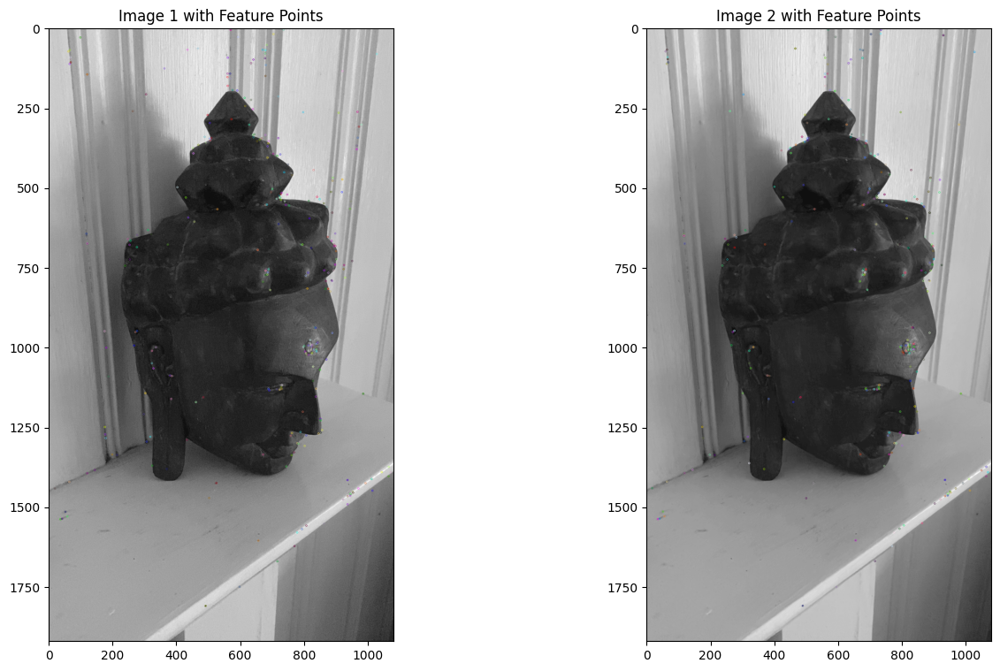

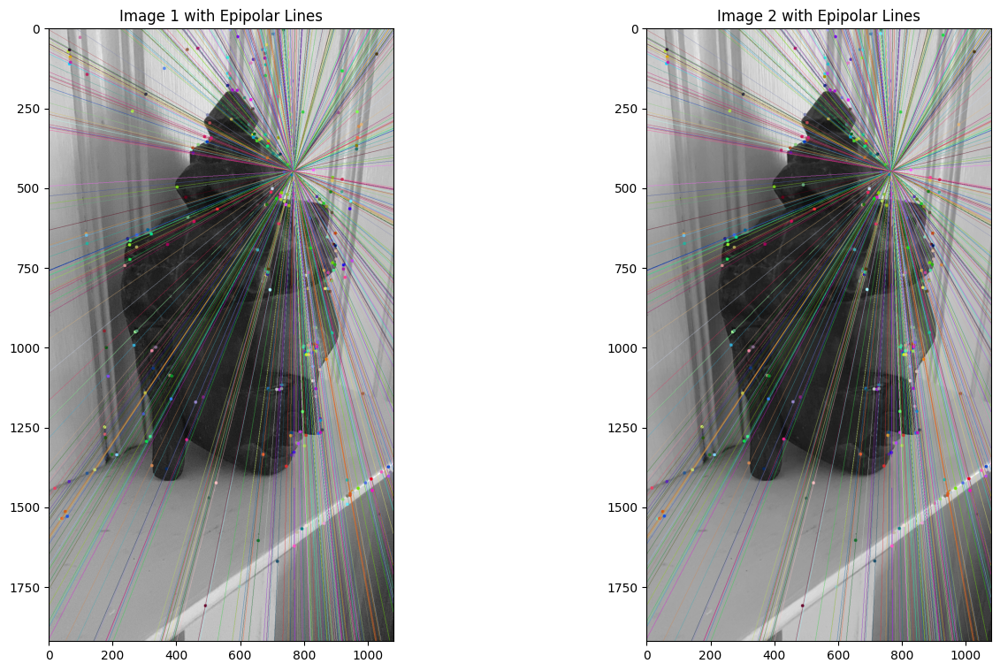

...

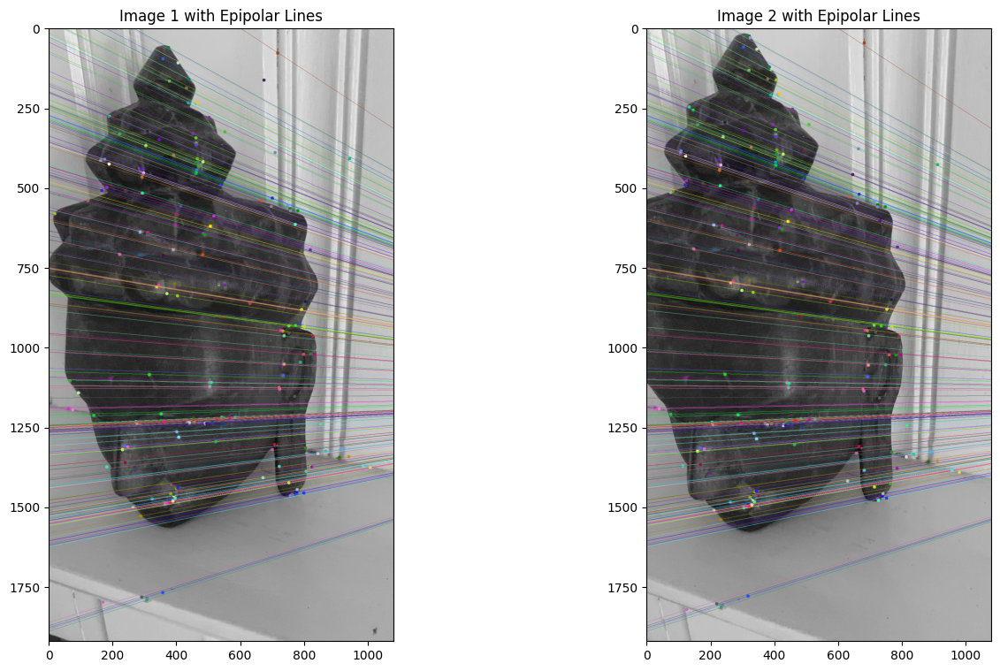

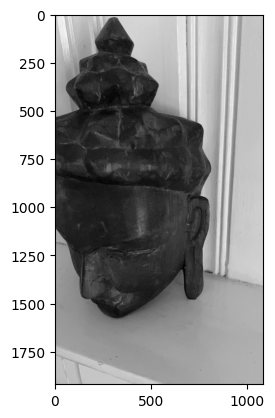

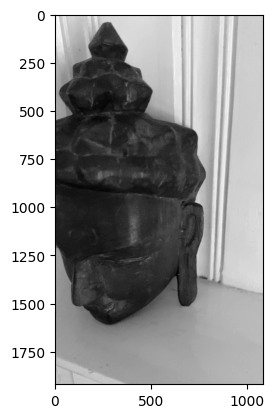

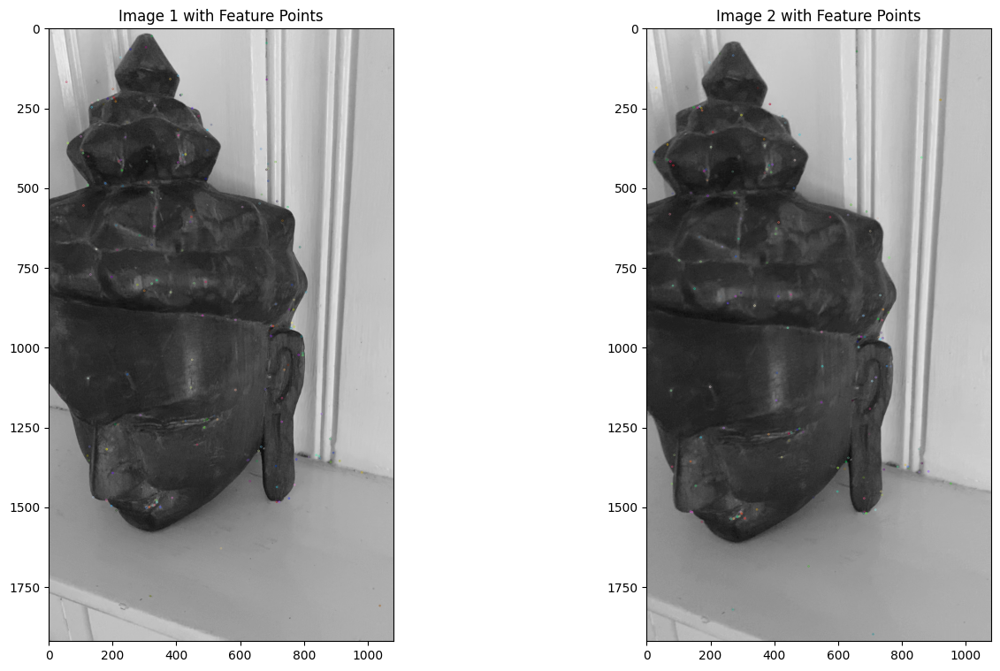

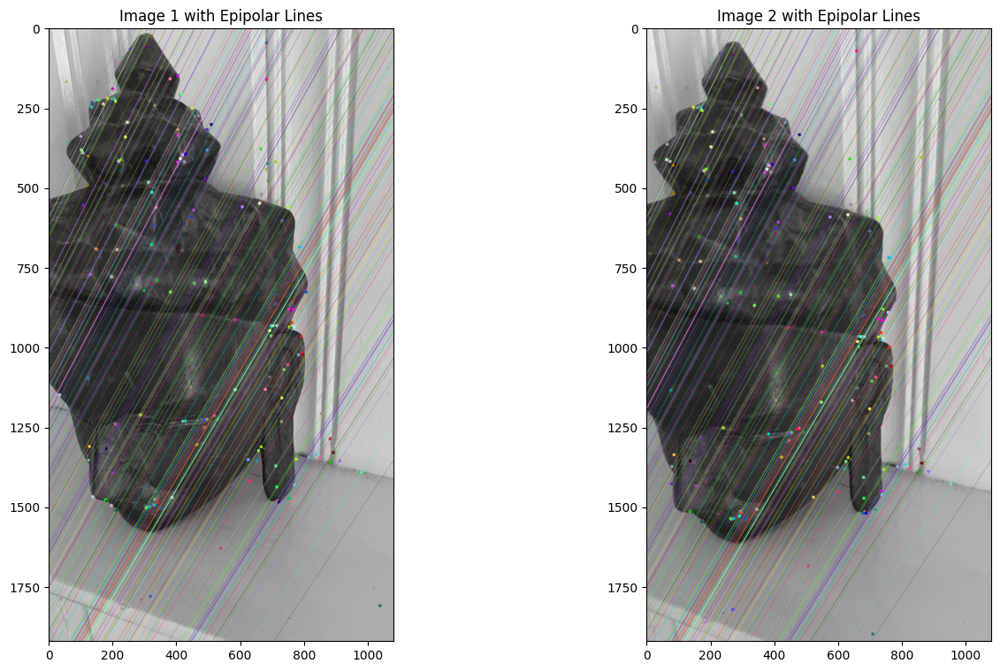

<__array_function__ internals>:180: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
c:\Users\ROHIT\AppData\Local\Programs\Python\Python311\Lib\site-packages\mpl_toolkits\mplot3d\proj3d.py:151: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  return np.array([xs, ys, zs, np.ones_like(xs)])


TypeError: only size-1 arrays can be converted to Python scalars

<Figure size 1200x800 with 1 Axes>

In [30]:
# Example usage
# image_folder = "data/images/buddha"
# image_files = [f"{image_folder}/buddha_00{i}.png" for i in range(1, 25)]  # Adjust the range accordingly
# plt.imshow(image_files[0])
# print(len(image_files))
curr_dir_path = os.getcwd()
images_dir = 'C:/Users/ROHIT/Downloads/Structure-From-Motion-SFM--master/Structure-From-Motion-SFM--master/data/images/buddha'

image_files = []
for filename in os.listdir(images_dir)[0:1]:
    file = os.path.join(images_dir, filename)
    img = cv2.imread(file, 0)
    # plt.figure()
    # plt.imshow(img)
    resized_img = img
    image_files.append(resized_img)

plt.figure()
plt.imshow(image_files[0])
# # Camera intrinsic matrix
# f = 1600
# x = 1080
# y = 1920
# K = np.array([[f, 0, x / 2], [0, f, y / 2], [0, 0, 1]])

# points_3d, points_2d = sfm(image_files, K)
# # plt.close()
# # Plot 3D points
# plot_3d_points(points_3d)

# Camera intrinsic matrix
f = 1600
x = 1080
y = 1920
K = np.array([[f, 0, x / 2], [0, f, y / 2], [0, 0, 1]])

points_3d, points_2d, camera_poses = sfm(image_files, K)
plot_3d_points_and_poses(points_3d, camera_poses)


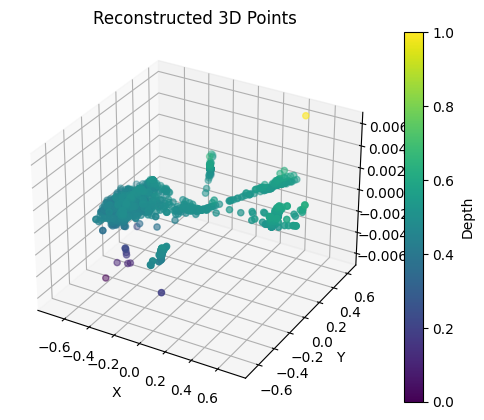

In [23]:
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D

def plot_3d_points(points_3d):
    fig = plt.figure()
    ax = fig.add_subplot(111, projection='3d')

    # Get depth values for color mapping
    depth = points_3d[:, 2]
    normalized_depth = (depth - np.min(depth)) / (np.max(depth) - np.min(depth))  # Normalize depth for colormap

    # Scatter plot with depth-based color mapping
    scatter = ax.scatter(points_3d[:, 0], points_3d[:, 1], points_3d[:, 2], c=normalized_depth, cmap='viridis', marker='o')

    # Add color bar for depth
    cbar = plt.colorbar(scatter, ax=ax, label='Depth')

    ax.set_xlabel('X')
    ax.set_ylabel('Y')
    ax.set_zlabel('Z')
    ax.set_title('Reconstructed 3D Points')

    plt.show()

# Example usage
# ... (your existing code)

# Plot 3D points with depth-based color mapping
plot_3d_points(points_3d)


In [24]:
from mayavi import mlab

def plot_3d_points_mayavi(points_3d):
    # Create a new Mayavi scene
    mlab.figure(bgcolor=(1, 1, 1), fgcolor=(0, 0, 0), size=(800, 600))

    # Scatter plot with interactive 3D visualization
    scatter = mlab.points3d(points_3d[:, 0], points_3d[:, 1], points_3d[:, 2], 
                            mode='point', colormap='viridis', scale_factor=0.05)  # Adjust scale_factor

    # Display the interactive plot
    mlab.show()

# Example usage
# ... (your existing code)

# Plot 3D points using Mayavi with adjusted scale_factor
plot_3d_points_mayavi(points_3d)
